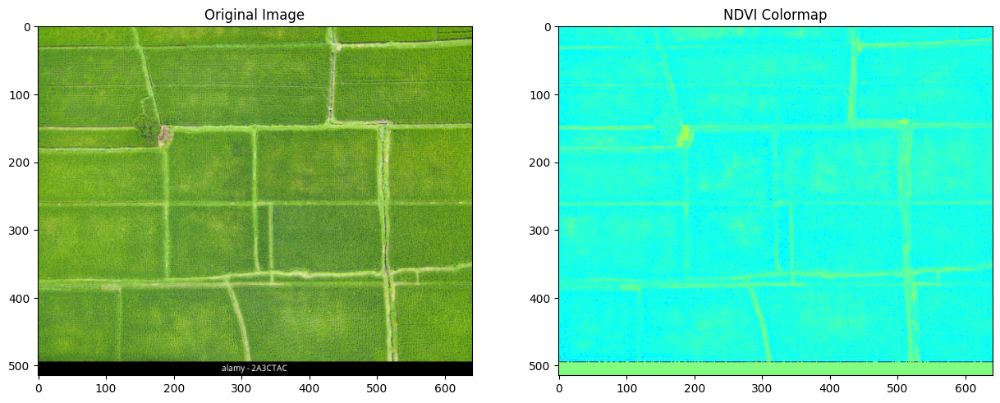

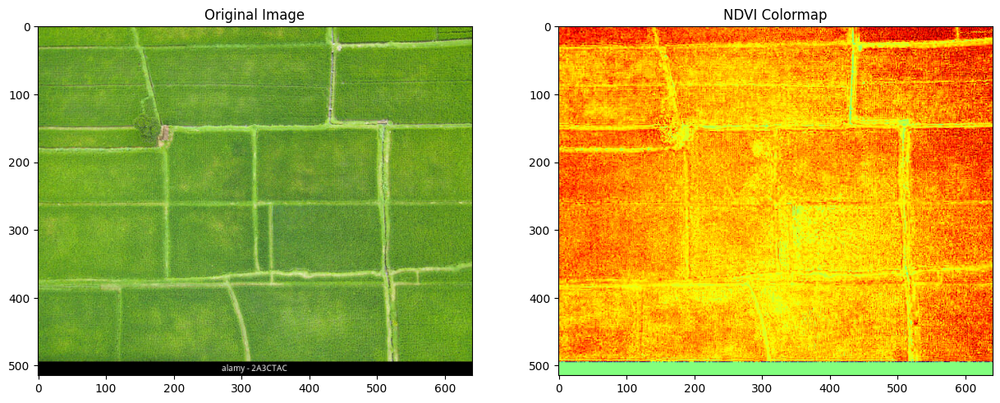

Percentage of Healthy Vegetation: 0.34%
Estimated Yield: 33.71 units


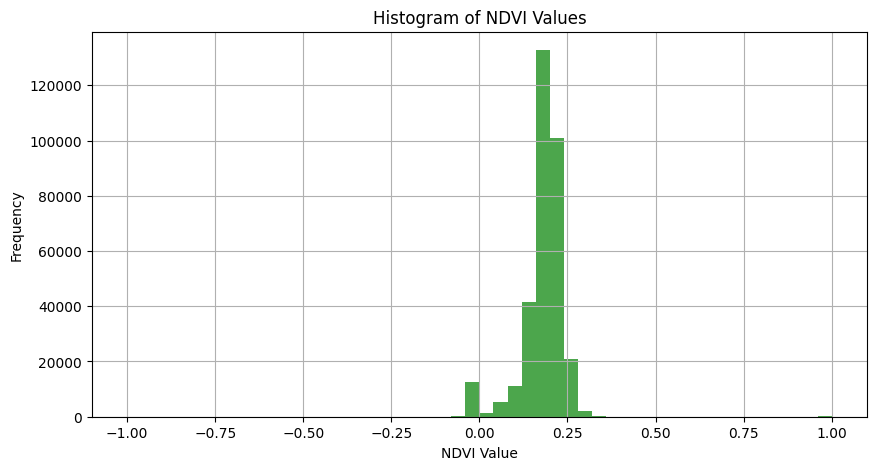

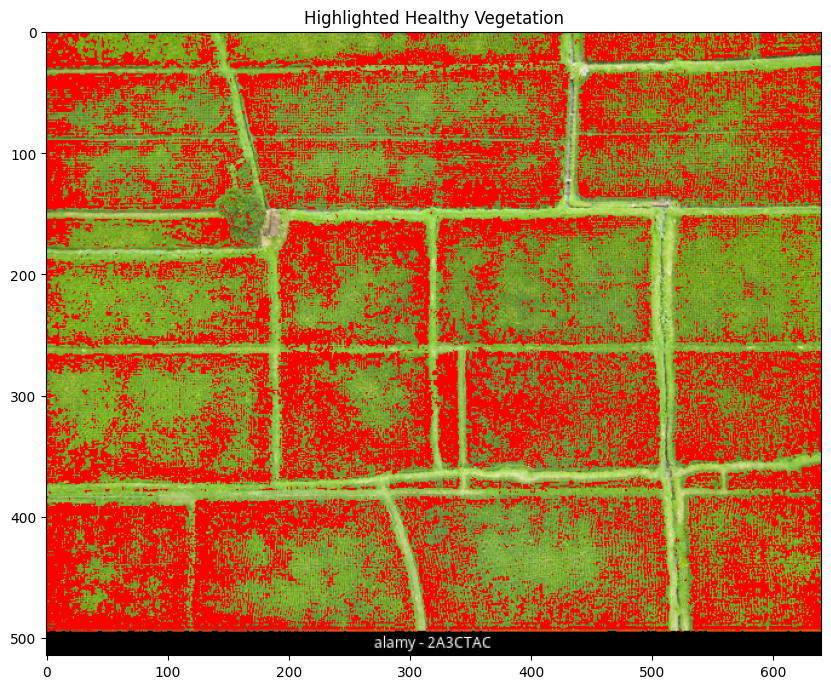

In [54]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    # Read the image
    image = cv2.imread(image_path)

    # Convert the image from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Split the image into its respective bands
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]

    # Assume NIR band is the green band for demonstration purposes (common for some RGB images)
    nir_band = green_band

    # Convert bands to float for division
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)

    # Calculate NDVI
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)  # Adding a small constant to avoid division by zero

    return ndvi, image
    
def calculate_ndvi1(image_path):
    # Read the image
    image = cv2.imread(image_path)

    # Convert the image from BGR to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Split the image into its respective bands
    red_band = image[:, :, 0]
    nir_band = image[:, :, 2]

    # Convert bands to float for division
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)

    # Calculate NDVI
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)  # Adding a small constant to avoid division by zero

    return ndvi, image

def visualize_ndvi(ndvi, original_image):
    # Normalize NDVI for visualization
    ndvi_normalized = cv2.normalize(ndvi, None, 0, 255, cv2.NORM_MINMAX)
    ndvi_normalized = ndvi_normalized.astype(np.uint8)

    # Apply a colormap for better visualization
    ndvi_colormap = cv2.applyColorMap(ndvi_normalized, cv2.COLORMAP_JET)

    # Display the original image and NDVI colormap side by side
    plt.figure(figsize=(15, 7))

    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)

    plt.subplot(1, 2, 2)
    plt.title('NDVI Colormap')
    plt.imshow(ndvi_colormap)

    plt.show()

def analyze_yield(ndvi):
    # Threshold to consider healthy vegetation for rice (e.g., NDVI > 0.3)
    healthy_threshold = 0.3
    healthy_pixels = np.sum(ndvi > healthy_threshold)
    total_pixels = ndvi.size

    # Calculate the percentage of healthy vegetation
    healthy_percentage = (healthy_pixels / total_pixels) * 100

    # Yield estimation based on the healthy vegetation percentage
    # This is a simplified assumption; in practice, you would need historical yield data to create a more accurate model
    estimated_yield = healthy_percentage * 100  # Example: yield per unit area

    return healthy_percentage, estimated_yield

def plot_ndvi_histogram(ndvi):
    # Plot histogram of NDVI values
    plt.figure(figsize=(10, 5))
    plt.hist(ndvi.ravel(), bins=50, color='green', alpha=0.7)
    plt.title('Histogram of NDVI Values')
    plt.xlabel('NDVI Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

def highlight_vegetation(ndvi, original_image):
    # Create a mask for healthy vegetation (e.g., NDVI > 0.3)
    healthy_threshold = 0.2 
    healthy_mask = ndvi > healthy_threshold

    # Create an output image to highlight healthy vegetation
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [255, 0, 0]  # Green for healthy vegetation

    # Display the highlighted vegetation image
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()

def main(image_path):
    ndvi, original_image = calculate_ndvi(image_path)
    ndvi1, original_image1 = calculate_ndvi1(image_path)
    visualize_ndvi(ndvi, original_image)
    visualize_ndvi(ndvi1, original_image)
    healthy_percentage, estimated_yield = analyze_yield(ndvi)
    print(f"Percentage of Healthy Vegetation: {healthy_percentage:.2f}%")
    print(f"Estimated Yield: {estimated_yield:.2f} units")
    plot_ndvi_histogram(ndvi)
    highlight_vegetation(ndvi, original_image)

# Path to the input image
image_path = 'r1.jpeg'

main(image_path)


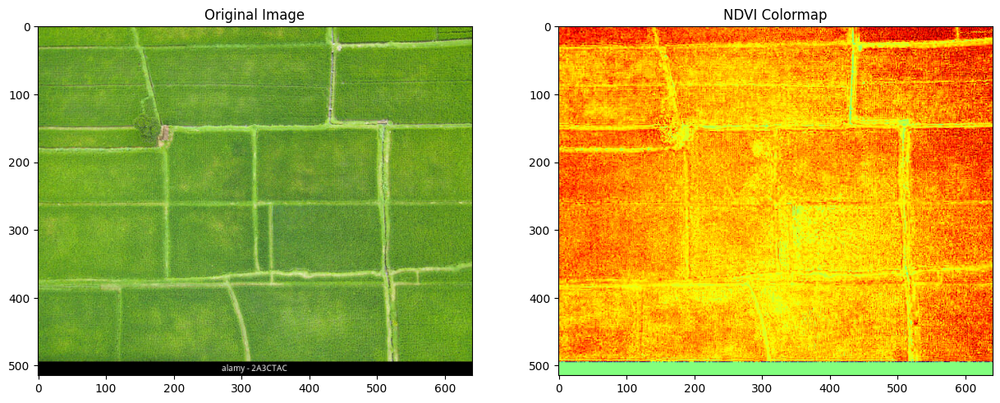

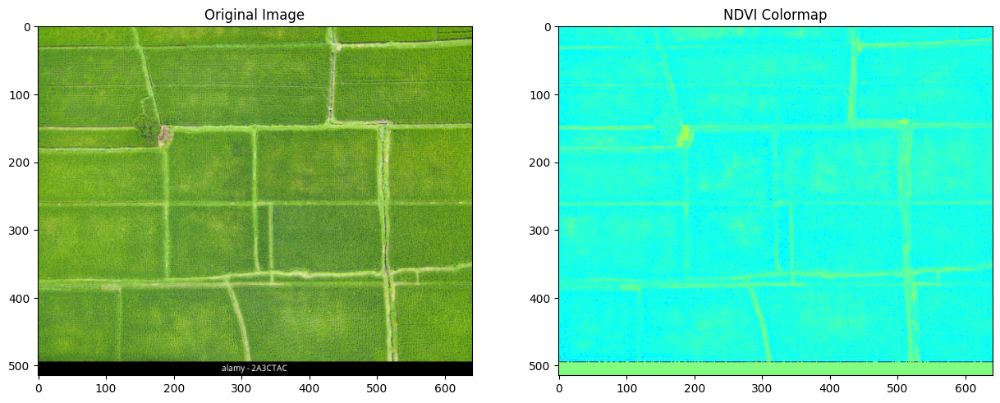

Percentage of Healthy Vegetation: 37.75%
Estimated Yield: 3774.82 units


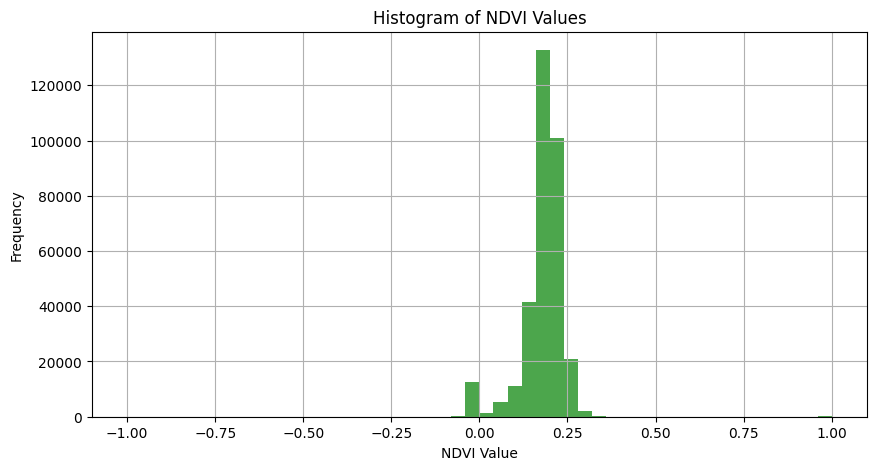

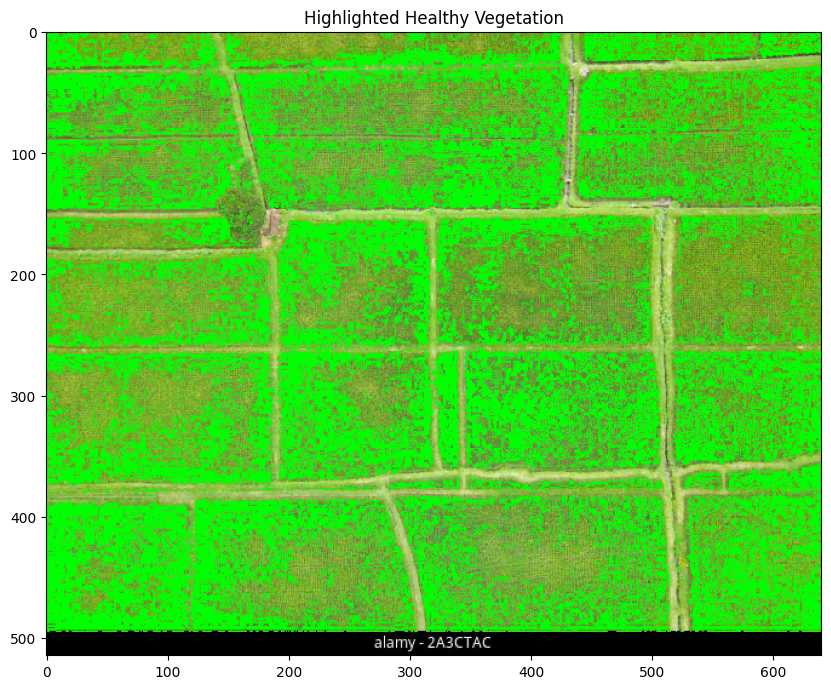

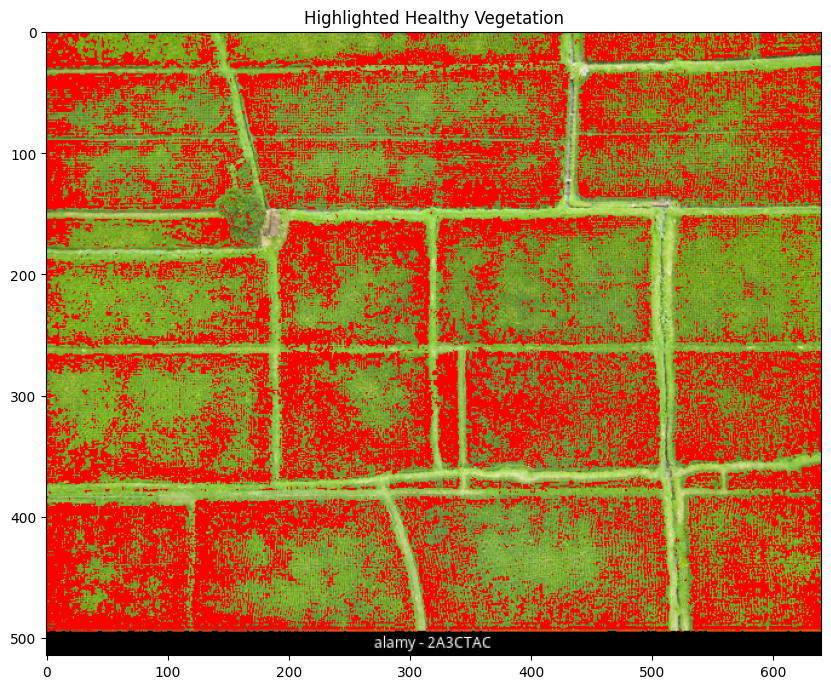

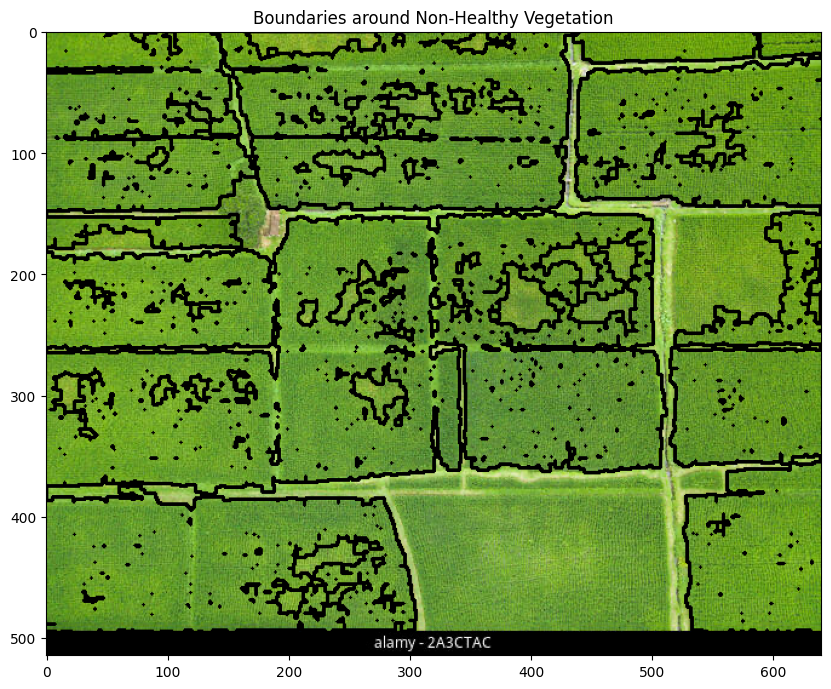

In [70]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def calculate_ndvi1(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    nir_band = image[:, :, 2]
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def visualize_ndvi(ndvi, original_image):
    ndvi_normalized = cv2.normalize(ndvi, None, 0, 255, cv2.NORM_MINMAX)
    ndvi_normalized = ndvi_normalized.astype(np.uint8)
    ndvi_colormap = cv2.applyColorMap(ndvi_normalized, cv2.COLORMAP_JET)
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)
    plt.subplot(1, 2, 2)
    plt.title('NDVI Colormap')
    plt.imshow(ndvi_colormap)
    plt.show()

def analyze_yield(ndvi):
    healthy_threshold = 0.2
    healthy_pixels = np.sum(ndvi > healthy_threshold)
    total_pixels = ndvi.size
    healthy_percentage = (healthy_pixels / total_pixels) * 100
    estimated_yield = healthy_percentage * 100
    return healthy_percentage, estimated_yield

def plot_ndvi_histogram(ndvi):
    plt.figure(figsize=(10, 5))
    plt.hist(ndvi.ravel(), bins=50, color='green', alpha=0.7)
    plt.title('Histogram of NDVI Values')
    plt.xlabel('NDVI Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

def highlight_vegetation(ndvi, original_image):
    healthy_threshold = 0.2
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [0, 255, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [255, 0, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()

def draw_boundaries(ndvi, original_image):
    non_healthy_threshold = 0.15
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_boundaries = original_image.copy()
    cv2.drawContours(image_with_boundaries, contours, -1, (0, 0, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.title('Boundaries around Non-Healthy Vegetation')
    plt.imshow(image_with_boundaries)
    plt.show()

def main(image_path):
    ndvi1, original_image1 = calculate_ndvi1(image_path)
    visualize_ndvi(ndvi1, original_image1)
    ndvi, original_image = calculate_ndvi(image_path)
    visualize_ndvi(ndvi, original_image)
    healthy_percentage, estimated_yield = analyze_yield(ndvi)
    print(f"Percentage of Healthy Vegetation: {healthy_percentage:.2f}%")
    print(f"Estimated Yield: {estimated_yield:.2f} units")
    plot_ndvi_histogram(ndvi)
    highlight_vegetation(ndvi, original_image)
    draw_boundaries(ndvi, original_image)

image_path = 'r1.jpeg'
main(image_path)

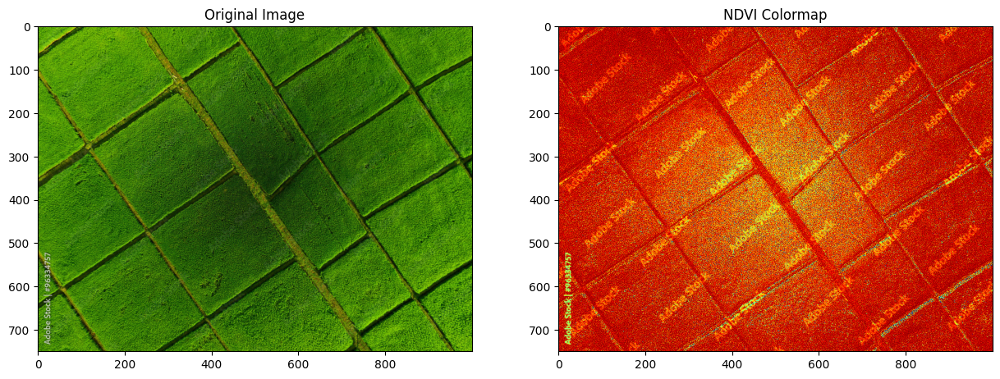

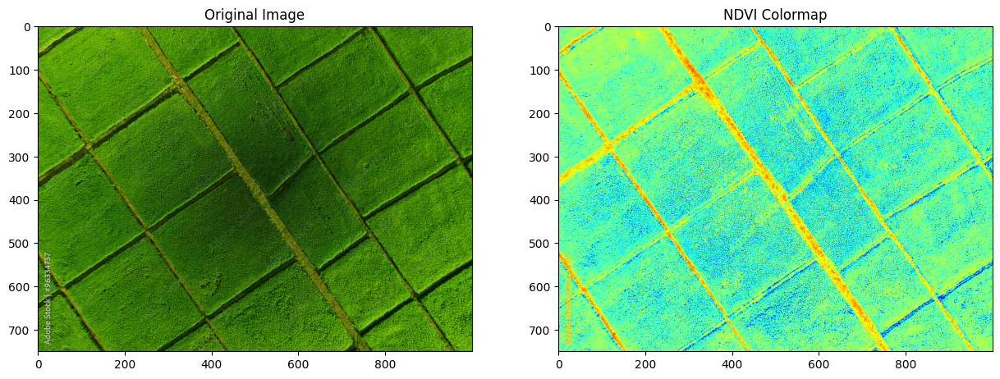

Percentage of Healthy Vegetation: 93.04%
Estimated Yield: 9304.35 units


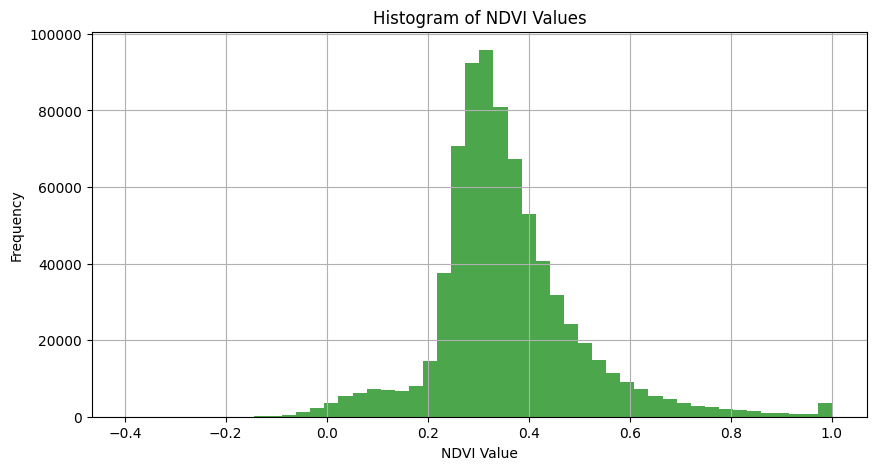

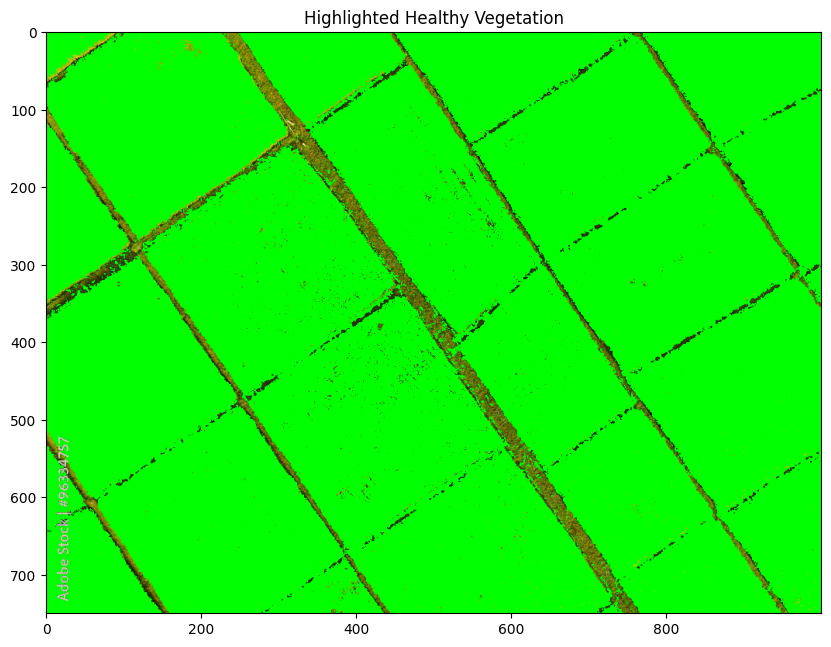

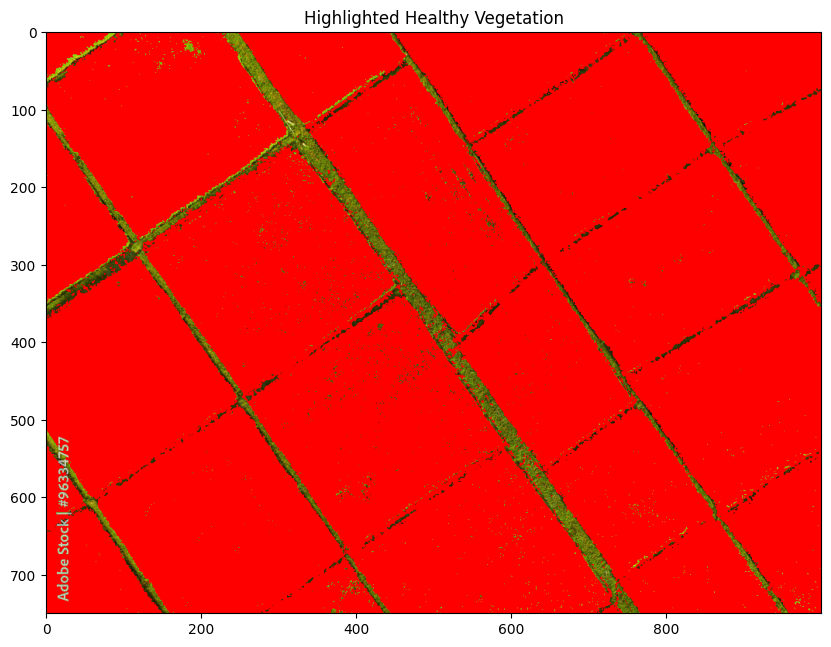

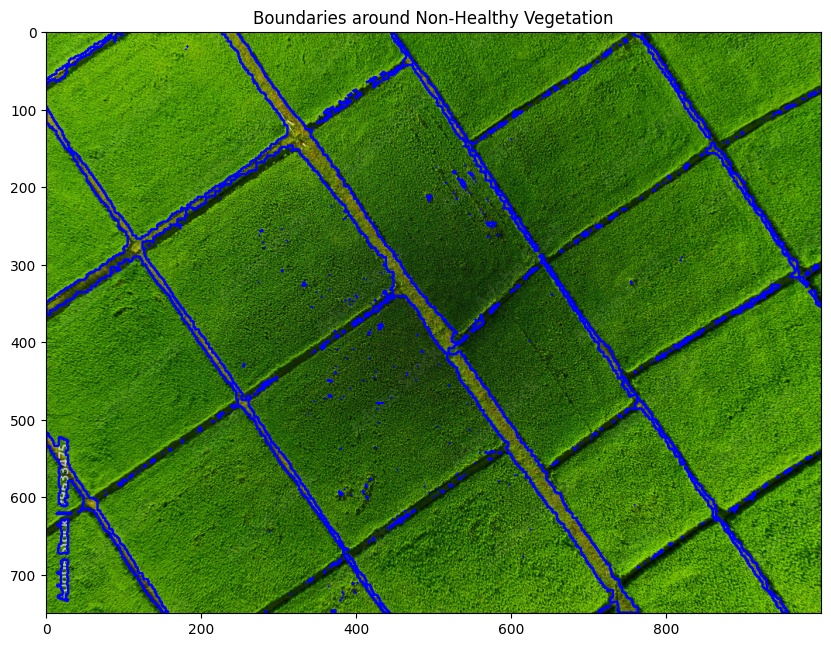

In [72]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def calculate_ndvi1(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    nir_band = image[:, :, 2]
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def visualize_ndvi(ndvi, original_image):
    ndvi_normalized = cv2.normalize(ndvi, None, 0, 255, cv2.NORM_MINMAX)
    ndvi_normalized = ndvi_normalized.astype(np.uint8)
    ndvi_colormap = cv2.applyColorMap(ndvi_normalized, cv2.COLORMAP_JET)
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)
    plt.subplot(1, 2, 2)
    plt.title('NDVI Colormap')
    plt.imshow(ndvi_colormap)
    plt.show()

def analyze_yield(ndvi):
    healthy_threshold = 0.2
    healthy_pixels = np.sum(ndvi > healthy_threshold)
    total_pixels = ndvi.size
    healthy_percentage = (healthy_pixels / total_pixels) * 100
    estimated_yield = healthy_percentage * 100
    return healthy_percentage, estimated_yield

def plot_ndvi_histogram(ndvi):
    plt.figure(figsize=(10, 5))
    plt.hist(ndvi.ravel(), bins=50, color='green', alpha=0.7)
    plt.title('Histogram of NDVI Values')
    plt.xlabel('NDVI Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

def highlight_vegetation(ndvi, original_image):
    healthy_threshold = 0.2
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [0, 255, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [255, 0, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()

def draw_boundaries(ndvi, original_image):
    non_healthy_threshold = 0.15
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_boundaries = original_image.copy()
    cv2.drawContours(image_with_boundaries, contours, -1, (0, 0, 255), 2)
    plt.figure(figsize=(10, 10))
    plt.title('Boundaries around Non-Healthy Vegetation')
    plt.imshow(image_with_boundaries)
    plt.show()

def main(image_path):
    ndvi1, original_image1 = calculate_ndvi1(image_path)
    visualize_ndvi(ndvi1, original_image1)
    ndvi, original_image = calculate_ndvi(image_path)
    visualize_ndvi(ndvi, original_image)
    healthy_percentage, estimated_yield = analyze_yield(ndvi)
    print(f"Percentage of Healthy Vegetation: {healthy_percentage:.2f}%")
    print(f"Estimated Yield: {estimated_yield:.2f} units")
    plot_ndvi_histogram(ndvi)
    highlight_vegetation(ndvi, original_image)
    draw_boundaries(ndvi, original_image)

image_path = 'r4.jpeg'
main(image_path)

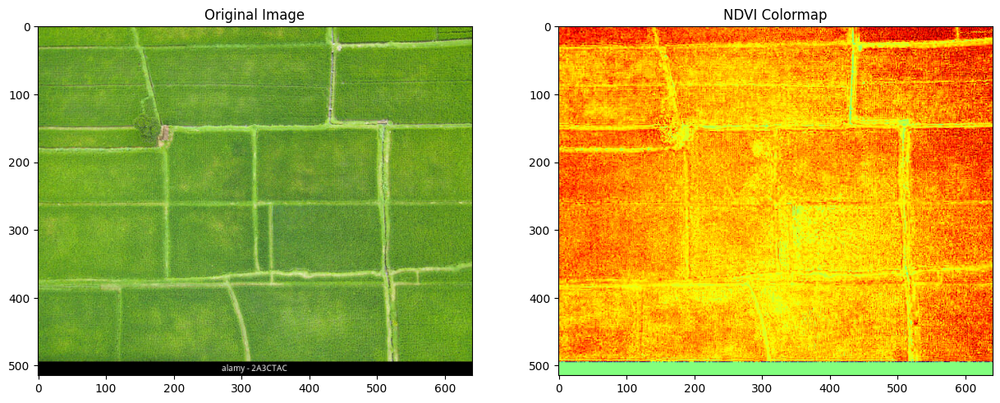

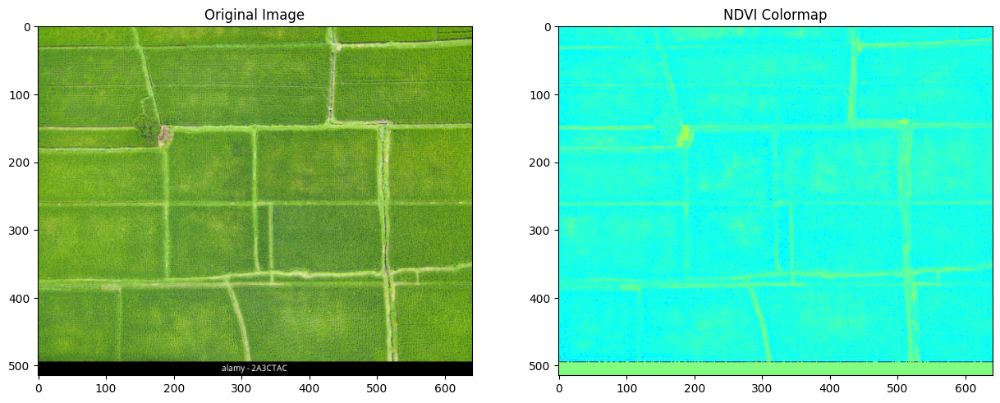

Percentage of Healthy Vegetation: 37.75%
Estimated Yield: 3774.82 units


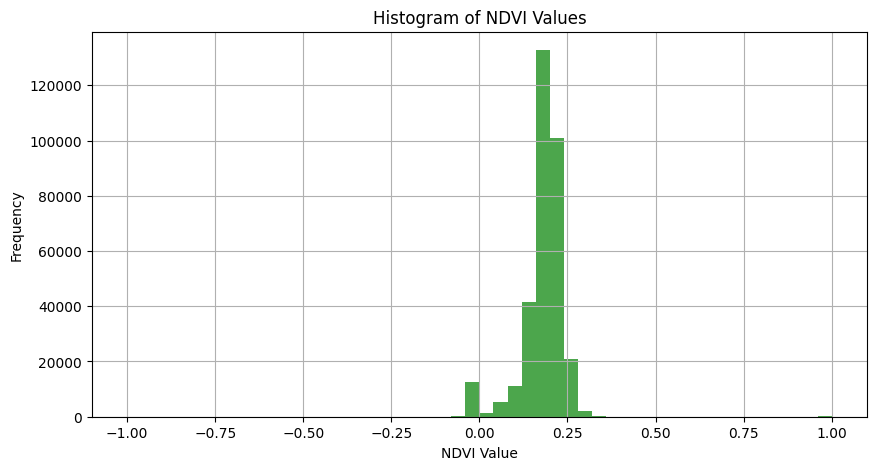

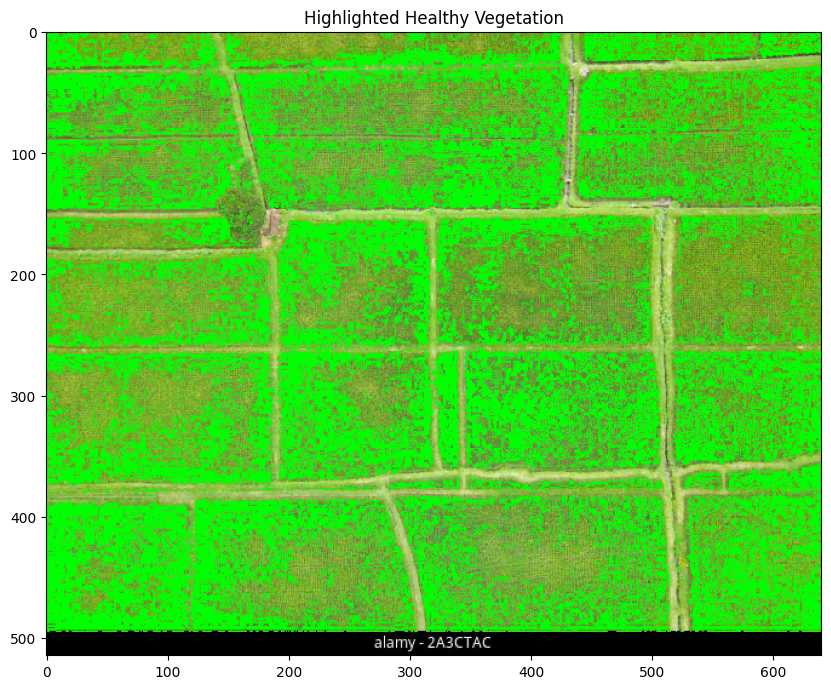

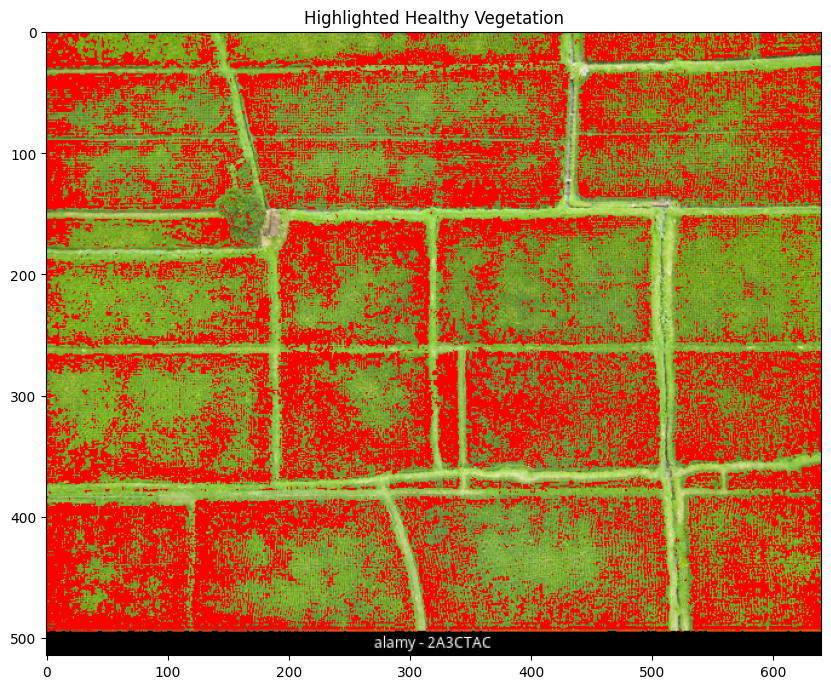

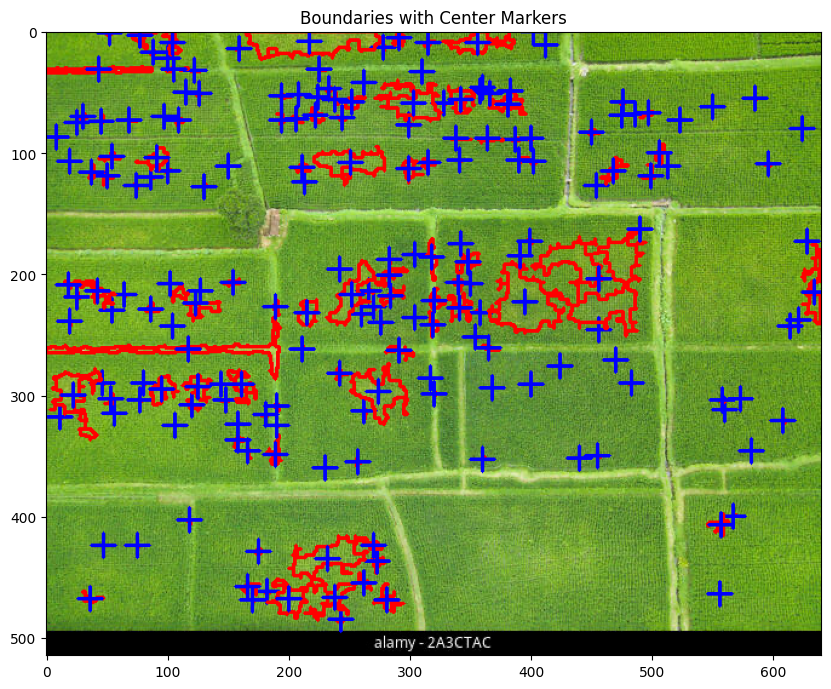

In [89]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def calculate_ndvi1(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    nir_band = image[:, :, 2]
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def visualize_ndvi(ndvi, original_image):
    ndvi_normalized = cv2.normalize(ndvi, None, 0, 255, cv2.NORM_MINMAX)
    ndvi_normalized = ndvi_normalized.astype(np.uint8)
    ndvi_colormap = cv2.applyColorMap(ndvi_normalized, cv2.COLORMAP_JET)
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)
    plt.subplot(1, 2, 2)
    plt.title('NDVI Colormap')
    plt.imshow(ndvi_colormap)
    plt.show()

def analyze_yield(ndvi):
    healthy_threshold = 0.2
    healthy_pixels = np.sum(ndvi > healthy_threshold)
    total_pixels = ndvi.size
    healthy_percentage = (healthy_pixels / total_pixels) * 100
    estimated_yield = healthy_percentage * 100
    return healthy_percentage, estimated_yield

def plot_ndvi_histogram(ndvi):
    plt.figure(figsize=(10, 5))
    plt.hist(ndvi.ravel(), bins=50, color='green', alpha=0.7)
    plt.title('Histogram of NDVI Values')
    plt.xlabel('NDVI Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

def highlight_vegetation(ndvi, original_image):
    healthy_threshold = 0.2
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [0, 255, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [255, 0, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()

def draw_boundaries_with_markers(ndvi, original_image):
    non_healthy_threshold = 0.15
    healthy_threshold = 0.2
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_boundaries = original_image.copy()
    for contour in contours:
        M = cv2.moments(contour)
        if M['m00'] != 0:
            cx = int(M['m10'] / M['m00'])
            cy = int(M['m01'] / M['m00'])
            if ndvi[cy, cx] <= healthy_threshold:
                cv2.drawContours(image_with_boundaries, [contour], -1, (255, 0, 0), 2)
                cv2.drawMarker(image_with_boundaries, (cx, cy), (0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=20, thickness=2)
    plt.figure(figsize=(10, 10))
    plt.title('Boundaries with Center Markers')
    plt.imshow(image_with_boundaries)
    plt.show()

def main(image_path):
    ndvi1, original_image1 = calculate_ndvi1(image_path)
    visualize_ndvi(ndvi1, original_image1)
    ndvi, original_image = calculate_ndvi(image_path)
    visualize_ndvi(ndvi, original_image)
    healthy_percentage, estimated_yield = analyze_yield(ndvi)
    print(f"Percentage of Healthy Vegetation: {healthy_percentage:.2f}%")
    print(f"Estimated Yield: {estimated_yield:.2f} units")
    plot_ndvi_histogram(ndvi)
    highlight_vegetation(ndvi, original_image)
    draw_boundaries_with_markers(ndvi, original_image)

image_path = 'r1.jpeg'
main(image_path)

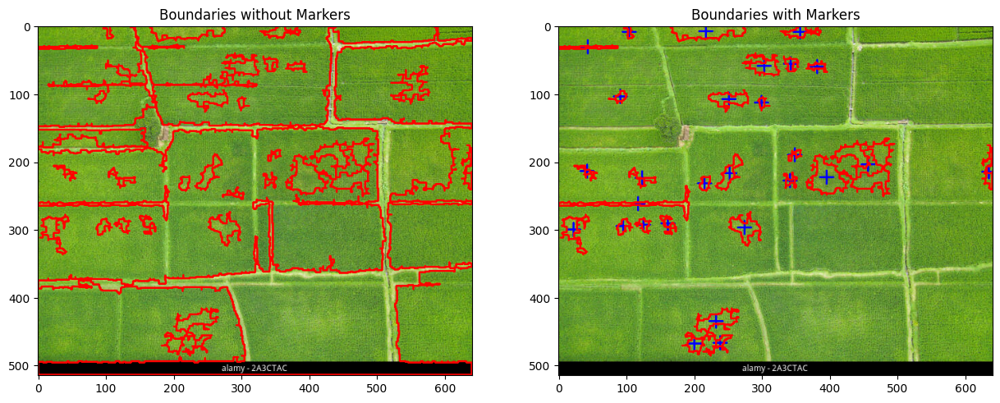

In [86]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def draw_boundaries_with_markers(ndvi, original_image, min_contour_area=100):
    non_healthy_threshold = 0.15
    healthy_threshold = 0.2
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    image_with_boundaries = original_image.copy()
    image_with_markers = original_image.copy()
    
    for contour in contours:
        if cv2.contourArea(contour) >= min_contour_area:
            M = cv2.moments(contour)
            if M['m00'] != 0:
                cx = int(M['m10'] / M['m00'])
                cy = int(M['m01'] / M['m00'])
                cv2.drawContours(image_with_boundaries, [contour], -1, (255, 0, 0), 2)
                if ndvi[cy, cx] <= healthy_threshold:
                    cv2.drawMarker(image_with_markers, (cx, cy), (0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=20, thickness=2)
                    cv2.drawContours(image_with_markers, [contour], -1, (255, 0, 0), 2)
                    
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Boundaries without Markers')
    plt.imshow(image_with_boundaries)
    plt.subplot(1, 2, 2)
    plt.title('Boundaries with Markers')
    plt.imshow(image_with_markers)
    plt.show()

def main(image_path):
    ndvi, original_image = calculate_ndvi(image_path)
    draw_boundaries_with_markers(ndvi, original_image)

image_path = 'r1.jpeg'
main(image_path)

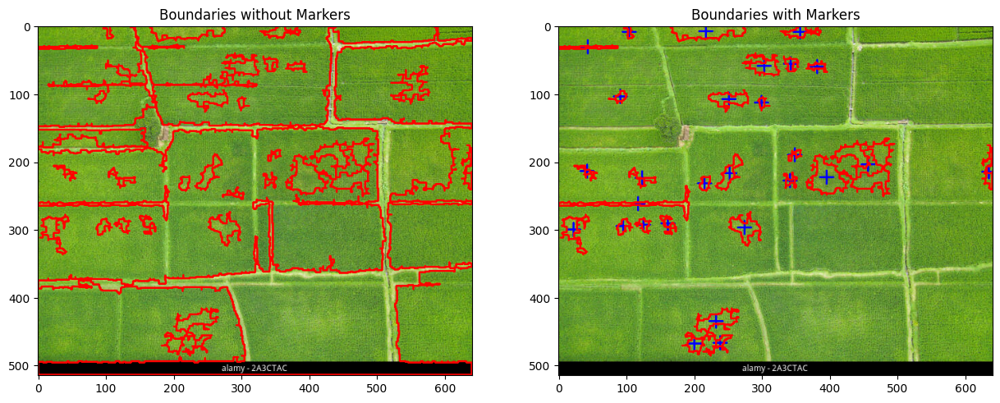

Marker at pixel (238, 467) corresponds to GPS coordinate (34.05224550882975, -118.24362823486328)
Marker at pixel (200, 468) corresponds to GPS coordinate (34.052247009277345, -118.24361633300781)
Marker at pixel (232, 435) corresponds to GPS coordinate (34.052244110107424, -118.2436361694336)
Marker at pixel (95, 295) corresponds to GPS coordinate (34.05224221547444, -118.24363708496094)
Marker at pixel (125, 293) corresponds to GPS coordinate (34.052240969340005, -118.24364685058593)
Marker at pixel (161, 291) corresponds to GPS coordinate (34.05223949432373, -118.24365844726563)
Marker at pixel (22, 300) corresponds to GPS coordinate (34.0522452545166, -118.24361328125)
Marker at pixel (274, 297) corresponds to GPS coordinate (34.052235488891604, -118.24369110107422)
Marker at pixel (117, 262) corresponds to GPS coordinate (34.052239697774255, -118.2436538696289)
Marker at pixel (215, 232) corresponds to GPS coordinate (34.052234433492025, -118.24369293212891)
Marker at pixel (341, 

In [23]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def draw_boundaries_with_markers(ndvi, original_image, min_contour_area=100):
    non_healthy_threshold = 0.15
    healthy_threshold = 0.2
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    image_with_boundaries = original_image.copy()
    image_with_markers = original_image.copy()
    markers_pixel_coords = [] 
    
    for contour in contours:
        if cv2.contourArea(contour) >= min_contour_area:
            M = cv2.moments(contour)
            if M['m00'] != 0:
                cx = int(M['m10'] / M['m00'])
                cy = int(M['m01'] / M['m00'])
                cv2.drawContours(image_with_boundaries, [contour], -1, (255, 0, 0), 2)
                if ndvi[cy, cx] <= healthy_threshold:
                    cv2.drawMarker(image_with_markers, (cx, cy), (0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=20, thickness=2)
                    cv2.drawContours(image_with_markers, [contour], -1, (255, 0, 0), 2)
                    markers_pixel_coords.append((cx, cy))
                    
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Boundaries without Markers')
    plt.imshow(image_with_boundaries)
    plt.subplot(1, 2, 2)
    plt.title('Boundaries with Markers')
    plt.imshow(image_with_markers)
    plt.show()
    
    return markers_pixel_coords

def pixel_to_gps(pixel_coord, ref_points_pixel, ref_points_gps):
    
    if len(ref_points_pixel) < 3 or len(ref_points_gps) < 3:
        raise ValueError("At least 3 reference points are required for a valid transformation.")

    pixel_points = np.array(ref_points_pixel, dtype=np.float32)
    gps_points = np.array(ref_points_gps, dtype=np.float32)

    transformation_matrix, _ = cv2.estimateAffine2D(pixel_points, gps_points)

    if transformation_matrix is None:
        raise ValueError("Failed to compute the transformation matrix. Check the reference points.")

    pixel_coord_with_ones = np.array([pixel_coord[0], pixel_coord[1], 1.0], dtype=np.float32)
    gps_coord = np.dot(transformation_matrix, pixel_coord_with_ones)


    return gps_coord[0], gps_coord[1]

def main(image_path):
    ndvi, original_image = calculate_ndvi(image_path)
    
    # Reference points with known pixel and GPS coordinates
    ref_points_pixel = [(100, 150), (400, 450), (200, 300)] 
    ref_points_gps = [(34.052235, -118.243683), (34.052237, -118.243680), (34.052240, -118.243670)] 


    markers_pixel_coords = draw_boundaries_with_markers(ndvi, original_image)
    
    gps_coordinates = []
    for marker_pixel in markers_pixel_coords:
        gps_coord = pixel_to_gps(marker_pixel, ref_points_pixel, ref_points_gps)
        gps_coordinates.append(gps_coord)
        print(f"Marker at pixel {marker_pixel} corresponds to GPS coordinate {gps_coord}")


    return gps_coordinates

image_path = 'r1.jpeg'
gps_coords = main(image_path)

In [24]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def calculate_ndvi1(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    nir_band = image[:, :, 2]
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def visualize_ndvi(ndvi, original_image):
    ndvi_normalized = cv2.normalize(ndvi, None, 0, 255, cv2.NORM_MINMAX)
    ndvi_normalized = ndvi_normalized.astype(np.uint8)
    ndvi_colormap = cv2.applyColorMap(ndvi_normalized, cv2.COLORMAP_JET)
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(original_image)
    plt.subplot(1, 2, 2)
    plt.title('NDVI Colormap')
    plt.imshow(ndvi_colormap)
    plt.show()

def analyze_yield(ndvi):
    healthy_threshold = 0.14
    healthy_pixels = np.sum(ndvi > healthy_threshold)
    total_pixels = ndvi.size
    healthy_percentage = (healthy_pixels / total_pixels) * 100
    estimated_yield = healthy_percentage * 100
    return healthy_percentage, estimated_yield

def plot_ndvi_histogram(ndvi):
    plt.figure(figsize=(10, 5))
    plt.hist(ndvi.ravel(), bins=50, color='green', alpha=0.7)
    plt.title('Histogram of NDVI Values')
    plt.xlabel('NDVI Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

def highlight_vegetation(ndvi, original_image):
    healthy_threshold = 0.14
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [0, 255, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()
    healthy_mask = ndvi > healthy_threshold
    highlighted_image = original_image.copy()
    highlighted_image[healthy_mask] = [255, 0, 0]
    plt.figure(figsize=(10, 10))
    plt.title('Highlighted Healthy Vegetation')
    plt.imshow(highlighted_image)
    plt.show()

def draw_boundaries_with_markers(ndvi, original_image):
    non_healthy_threshold = 0.12
    healthy_threshold = 0.14
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_boundaries = original_image.copy()
    for contour in contours:
        M = cv2.moments(contour)
        if M['m00'] != 0:
            cx = int(M['m10'] / M['m00'])
            cy = int(M['m01'] / M['m00'])
            if ndvi[cy, cx] <= healthy_threshold:
                cv2.drawContours(image_with_boundaries, [contour], -1, (255, 0, 0), 2)
                cv2.drawMarker(image_with_boundaries, (cx, cy), (0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=20, thickness=2)
    plt.figure(figsize=(10, 10))
    plt.title('Boundaries with Center Markers')
    plt.imshow(image_with_boundaries)
    plt.show()

def main(image_path):
    ndvi1, original_image1 = calculate_ndvi1(image_path)
    visualize_ndvi(ndvi1, original_image1)
    ndvi, original_image = calculate_ndvi(image_path)
    visualize_ndvi(ndvi, original_image)
    healthy_percentage, estimated_yield = analyze_yield(ndvi)
    print(f"Percentage of Healthy Vegetation: {healthy_percentage:.2f}%")
    print(f"Estimated Yield: {estimated_yield:.2f} units")
    plot_ndvi_histogram(ndvi)
    highlight_vegetation(ndvi, original_image)
    draw_boundaries_with_markers(ndvi, original_image)

image_path = 'rp.jpeg'
main(image_path)

[ WARN:0@3253.282] global loadsave.cpp:248 findDecoder imread_('rp.jpeg'): can't open/read file: check file path/integrity


error: OpenCV(4.9.0) /Users/xperience/GHA-OpenCV-Python2/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def calculate_ndvi(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    red_band = image[:, :, 0]
    green_band = image[:, :, 1]
    blue_band = image[:, :, 2]
    nir_band = green_band
    red_band = red_band.astype(float)
    nir_band = nir_band.astype(float)
    ndvi = (nir_band - red_band) / (nir_band + red_band + 1e-5)
    return ndvi, image

def draw_boundaries_with_markers(ndvi, original_image, min_contour_area=100):
    non_healthy_threshold = 0.12
    healthy_threshold = 0.14
    non_healthy_mask = ndvi <= non_healthy_threshold
    non_healthy_mask_uint8 = (non_healthy_mask * 255).astype(np.uint8)
    kernel = np.ones((5, 5), np.uint8)
    non_healthy_mask_cleaned = cv2.morphologyEx(non_healthy_mask_uint8, cv2.MORPH_CLOSE, kernel)
    contours, _ = cv2.findContours(non_healthy_mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    image_with_boundaries = original_image.copy()
    image_with_markers = original_image.copy()
    markers_pixel_coords = [] 
    
    for contour in contours:
        if cv2.contourArea(contour) >= min_contour_area:
            M = cv2.moments(contour)
            if M['m00'] != 0:
                cx = int(M['m10'] / M['m00'])
                cy = int(M['m01'] / M['m00'])
                cv2.drawContours(image_with_boundaries, [contour], -1, (255, 0, 0), 2)
                if ndvi[cy, cx] <= healthy_threshold:
                    cv2.drawMarker(image_with_markers, (cx, cy), (0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=20, thickness=2)
                    cv2.drawContours(image_with_markers, [contour], -1, (255, 0, 0), 2)
                    markers_pixel_coords.append((cx, cy))
                    
    plt.figure(figsize=(15, 7))
    plt.subplot(1, 2, 1)
    plt.title('Boundaries without Markers')
    plt.imshow(image_with_boundaries)
    plt.subplot(1, 2, 2)
    plt.title('Boundaries with Markers')
    plt.imshow(image_with_markers)
    plt.show()

def main(image_path):
    ndvi, original_image = calculate_ndvi(image_path)
    draw_boundaries_with_markers(ndvi, original_image)

image_path = 'rp.jpeg'
main(image_path)

[ WARN:0@3257.696] global loadsave.cpp:248 findDecoder imread_('rp.jpeg'): can't open/read file: check file path/integrity


error: OpenCV(4.9.0) /Users/xperience/GHA-OpenCV-Python2/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'
